In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image
import matplotlib.image as mpimg

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image as image_utils

from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense

2024-04-16 13:25:39.244377: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-16 13:25:39.244443: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-16 13:25:39.245213: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-16 13:25:39.250988: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [48]:
image_dir = './Jaws_labeled_images'

In [3]:
# Input image dimensions, etc.
resized_height = 224
resized_width = 224
num_channel = 3 
num_classes = 18
batch_size = 32 

In [87]:
# load train images without batching
train_images = image_dataset_from_directory(
    image_dir, labels='inferred', label_mode='categorical',
     color_mode='rgb', image_size=(resized_height ,
    resized_width ), batch_size=32, shuffle=True, seed=42, validation_split=0.2, subset='training',
    interpolation='bilinear', follow_links=False,
    crop_to_aspect_ratio=False)
print(train_images)

Found 110 files belonging to 18 classes.
Using 88 files for training.
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 18), dtype=tf.float32, name=None))>


['Carcharhinidae', 'Carcharhinus', 'Carcharhinus_brachyurus', 'Carcharhinus_leucas', 'Carcharhinus_limbatus', 'Carcharhinus_perezi', 'Carcharias_taurus', 'Carcharodon_carcharias', 'Galeocerdo_cuvier', 'Ginglymostoma_cirratum', 'Isistius_brasiliensis', 'Isurus_oxyrhinchus', 'Nebrius_ferrugineus', 'Negaprion_acutidens', 'Orectolobus', 'Orectolobus_ornatus', 'Squatina', 'Triaenodon_obesus\xa0']
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)


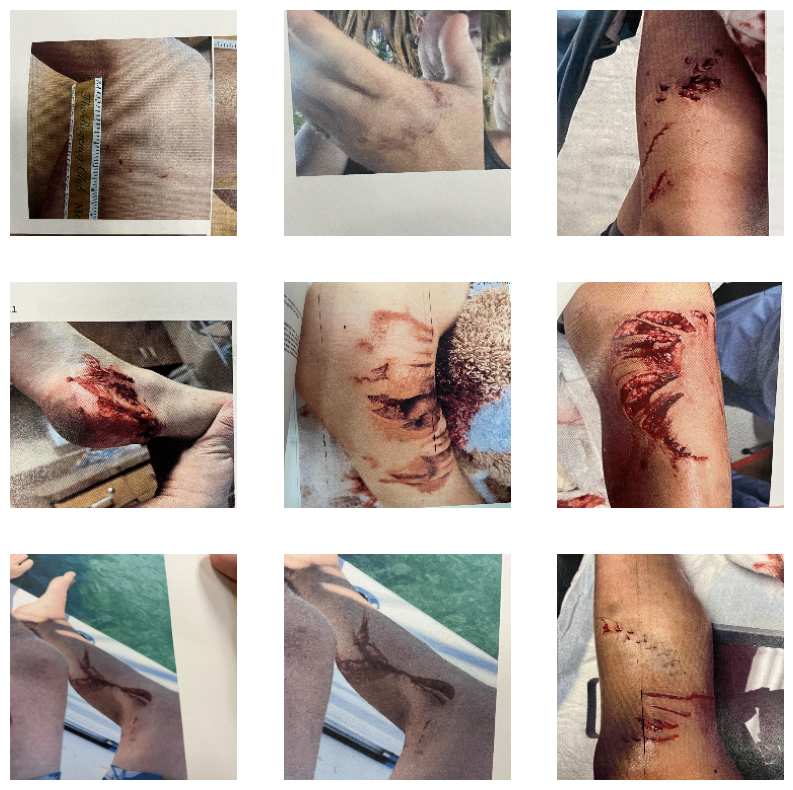

In [38]:
# Note that the images have been loaded with 3 color channels!
class_names = train_images.class_names
print(class_names)
plt.figure(figsize=(10, 10))
for images, labels in train_images.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    #plt.title(class_names[labels[i]])
    plt.axis("off")
    print(images[i].shape)

In [106]:
for images, labels in train_images.take(1):
    image_array = np.array(images)
    label_array = np.array(labels)
    print("Images batch shape:", image_array.shape)
    print("Labels batch shape:", label_array.shape)


Images batch shape: (32, 224, 224, 3)
Labels batch shape: (32, 18)


In [26]:
from keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest')


In [ ]:
# from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

# def augment_images(image, label):
#     image = datagen.random_transform(image)
#     return image, label
# input_shape = (224, 224, 3)

# augmented_dataset = train_images.map(augment_images)

In [53]:
# # test script with one image
# img = load_img('./Jaws_labeled_images/Carcharhinidae/IMG_0180_Large.png')
# x = img_to_array(img)
# x = x.reshape((1,) + x.shape)
# print(x.shape)

(1, 1280, 960, 3)


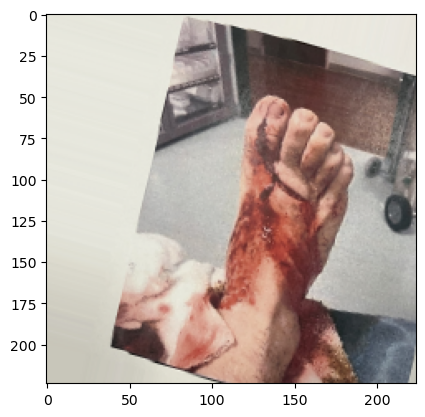

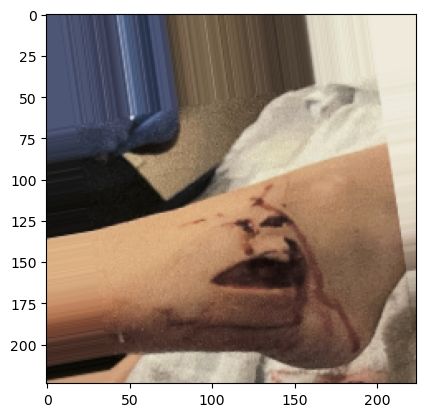

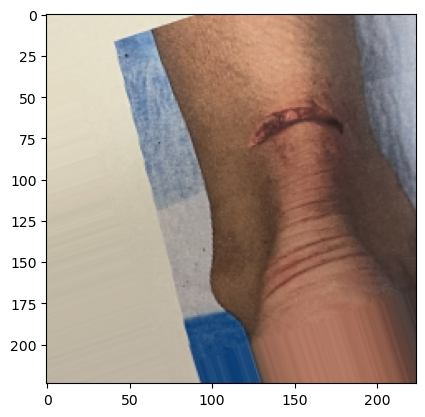

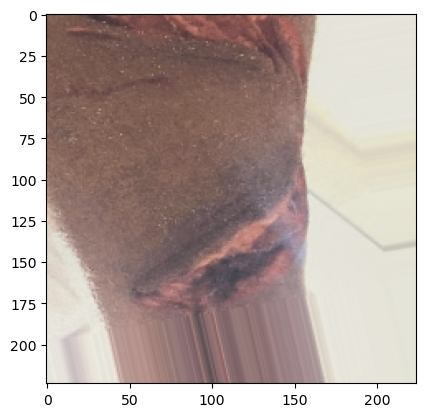

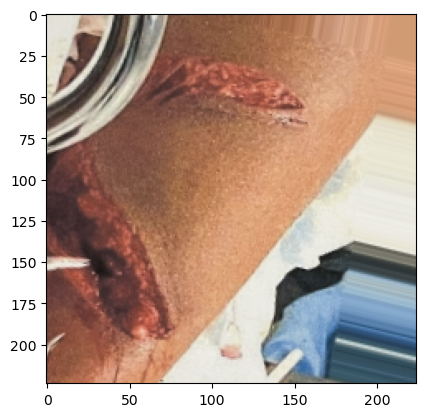

...

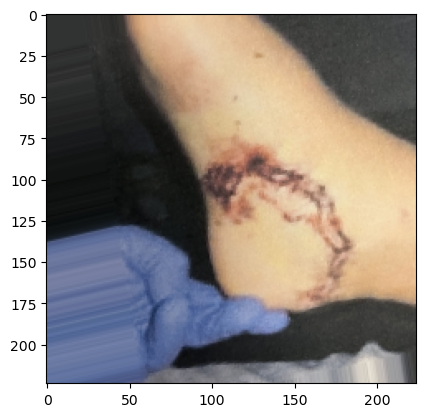

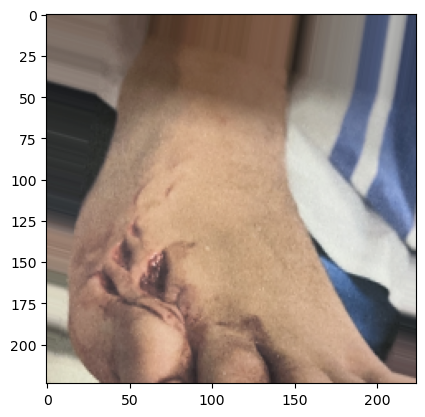

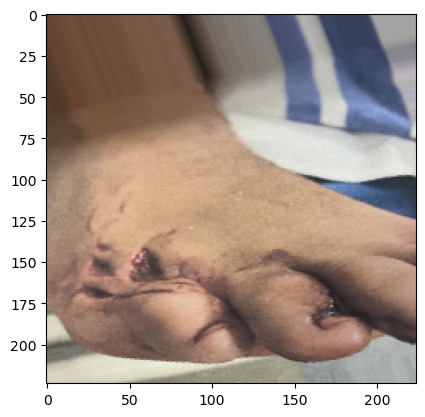

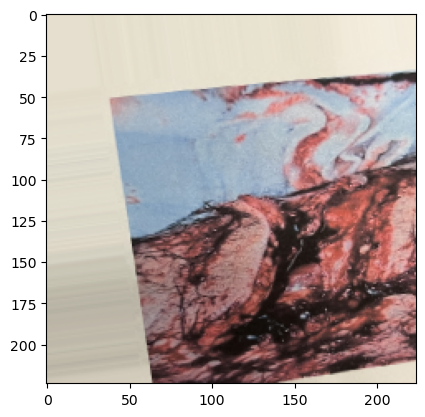

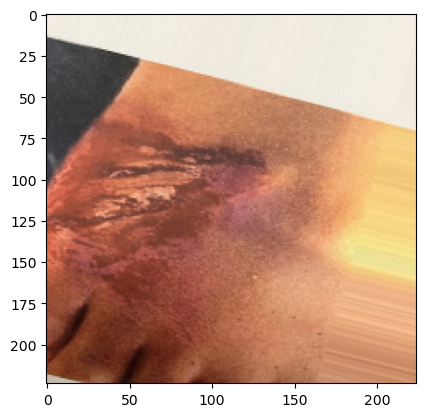

In [105]:
augmented_images = datagen.flow(image_array)

for i in range(batch_size):
    augmented_image = next(augmented_images)[0]  # Retrieve the augmented image from the generator
    plt.imshow(augmented_image.astype('uint8')) # Plot the augmented image
    plt.show()

(32, 224, 224, 3) (32, 18)


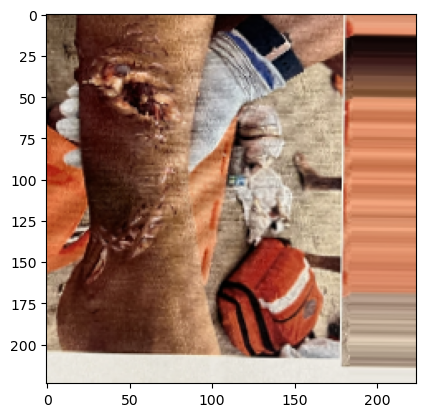

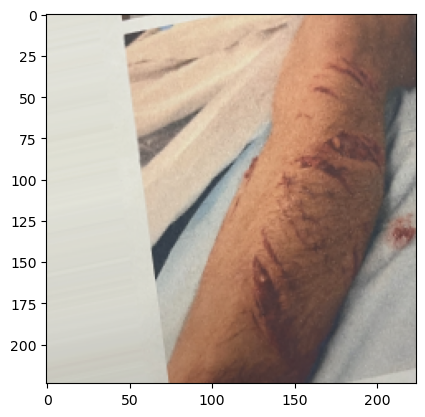

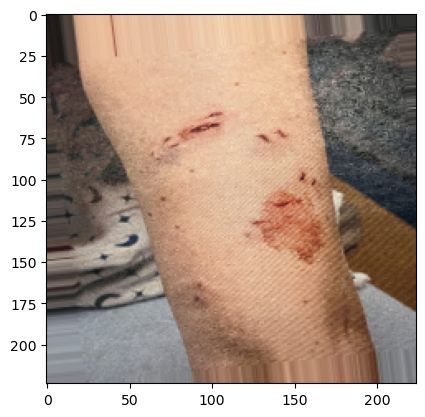

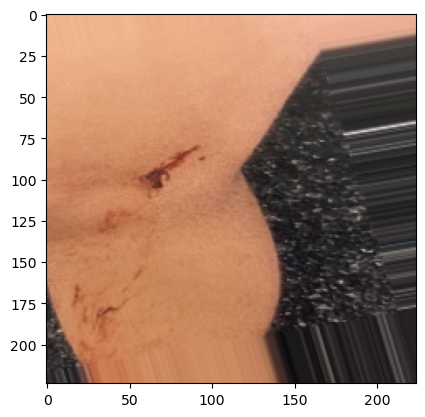

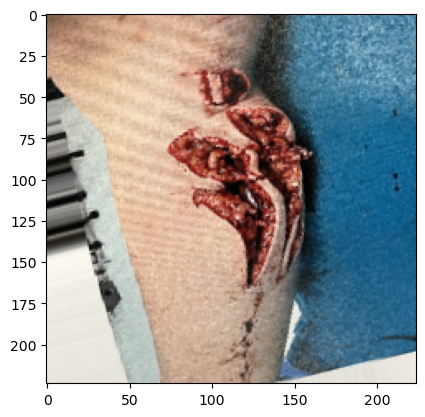

...

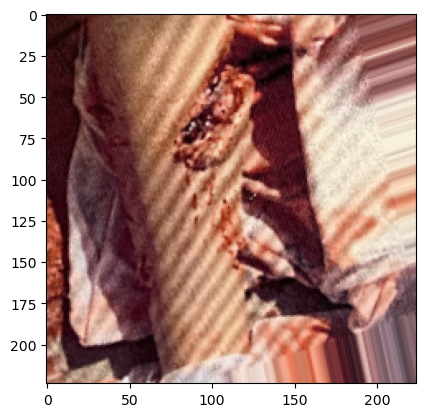

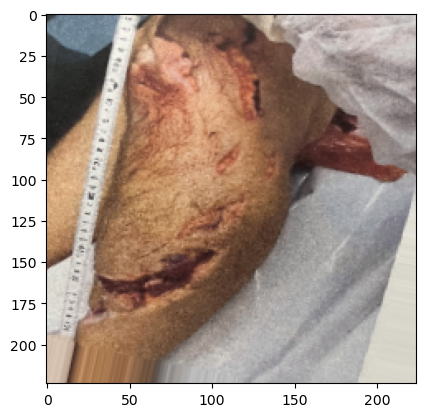

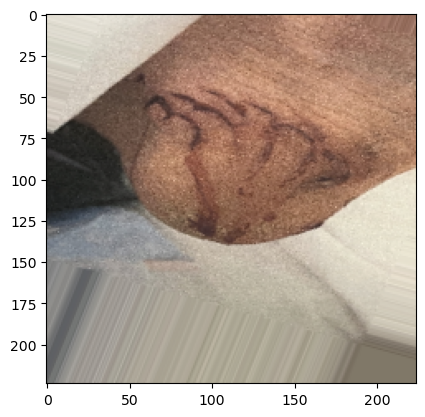

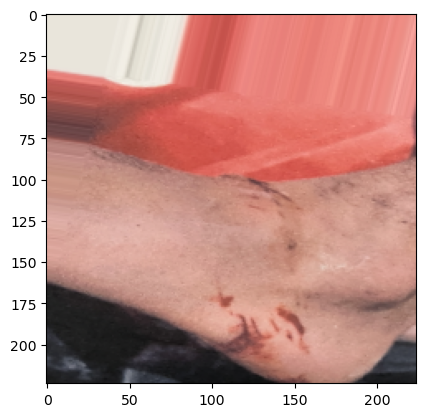

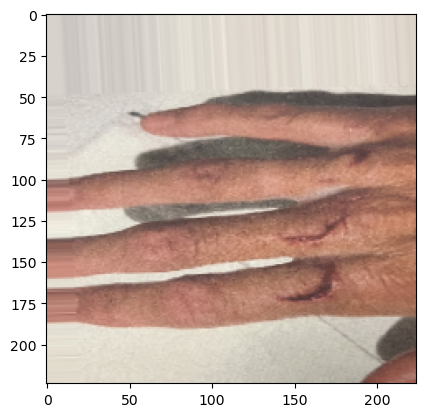

In [112]:
# # Reshape the image to (1, height, width, channels) for the datagen.flow() method
# image = np.expand_dims(x, axis=0)

# Generate augmented images indefinitely
augmented_images = datagen.flow(image_array, label_array, batch_size=batch_size)

x, y = next(augmented_images)
print(x.shape, y.shape)
# fig, ax = plt.subplots(nrows=4, ncols=8)
for i in range(batch_size):
    image = x[i]
#     ax.flatten()[i].imshow(np.squeeze(image))
    plt.imshow(image.astype('uint8'))
    plt.show()



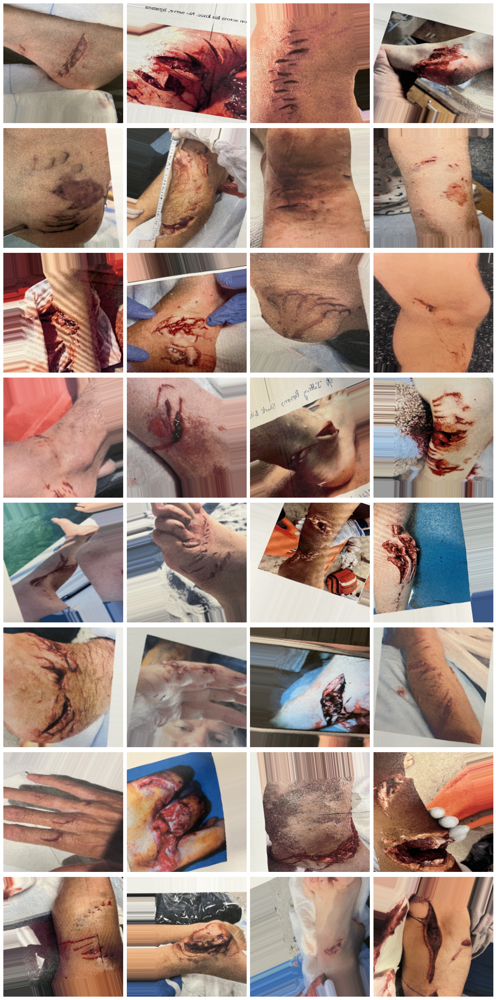

In [122]:
augmented_images = datagen.flow(image_array, label_array, batch_size=batch_size)

x, y = next(augmented_images)

num_rows = 8
num_cols = 4

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 30))

for i in range(batch_size):
    row = i // num_cols
    col = i % num_cols
    augmented_image = x[i]
    axes[row, col].imshow(augmented_image.astype('uint8'))  # Plot the augmented image
    axes[row, col].axis('off')  # Turn off axis labels

plt.tight_layout()
plt.show()

# Below are test scripts

In [ ]:


import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define an ImageDataGenerator with augmentation parameters
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Load a sample image
image = np.random.random((224, 224, 3))

# Reshape the image to (1, height, width, channels) for the datagen.flow() method
image = np.expand_dims(image, axis=0)

# Generate augmented images indefinitely
augmented_images = datagen.flow(image)

# Specify how many augmented images you want to generate
num_images_to_generate = 5

# Generate and plot the specified number of augmented images
for i in range(num_images_to_generate):
    augmented_image = next(augmented_images)[0]  # Retrieve the augmented image from the generator
    plt.imshow(augmented_image.astype('uint8'))  # Plot the augmented image
    plt.show()


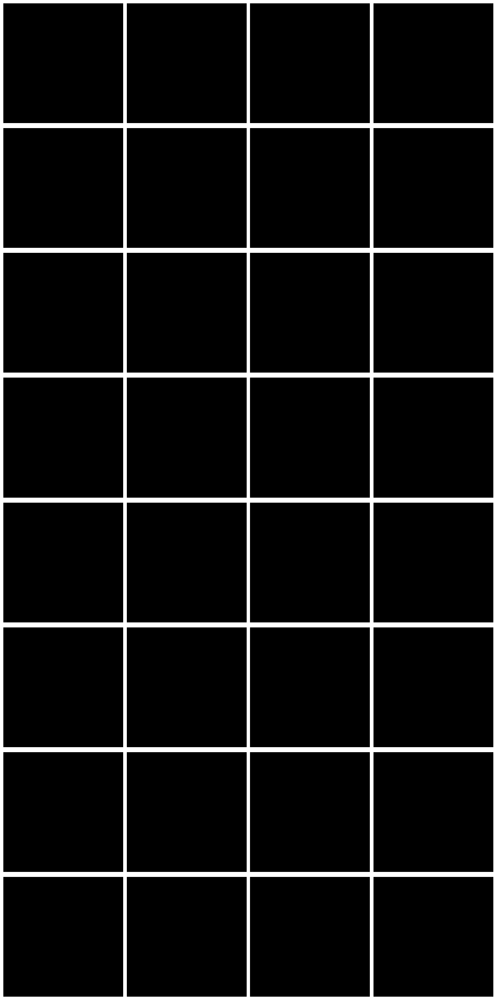

In [119]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define an ImageDataGenerator with augmentation parameters
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Load a sample image
image = np.random.random((224, 224, 3))

# Reshape the image to (1, height, width, channels) for the datagen.flow() method
image = np.expand_dims(image, axis=0)

# Generate augmented images indefinitely
augmented_images = datagen.flow(image)

# Generate and plot 32 augmented images in an 8x4 grid plot
num_images_to_generate = 32
num_rows = 8
num_cols = 4

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 30))

for i in range(num_images_to_generate):
    row = i // num_cols
    col = i % num_cols
    augmented_image = next(augmented_images)[0]  # Retrieve the augmented image from the generator
    axes[row, col].imshow(augmented_image.astype('uint8'))  # Plot the augmented image
    axes[row, col].axis('off')  # Turn off axis labels

plt.tight_layout()
plt.show()
